In [628]:
import numpy as np   
import pandas as pd    
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import matplotlib.pyplot as plt   
import matplotlib.style

In [629]:
df = pd.read_excel("compactiv.xlsx")

In [630]:
df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,NaN,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,NaN,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,NaN,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [631]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8088 non-null   float64
 8   wchar     8177 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

In [632]:
df.describe(include="all")

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
count,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8.088000e+03,8.177000e+03,8192.000000,...,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192.000000,8192,8192.000000,8.192000e+03,8192.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,2,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,Not_CPU_Bound,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,4331,NaN,NaN,NaN
mean,19.559692,13.106201,2306.318237,210.479980,150.058228,1.884554,2.791998,1.973857e+05,9.590299e+04,2.285317,...,21.526849,1.127505,8.277960,12.388586,109.793799,185.315796,NaN,1763.456299,1.328126e+06,83.968872
std,53.353799,29.891726,1633.617322,198.980146,160.478980,2.479493,5.212456,2.398375e+05,1.408417e+05,5.307038,...,71.141340,5.708347,13.874978,22.281318,114.419221,191.000603,NaN,2482.104511,4.220194e+05,18.401905
min,0.000000,0.000000,109.000000,6.000000,7.000000,0.000000,0.000000,2.780000e+02,1.498000e+03,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.200000,NaN,55.000000,2.000000e+00,0.000000
25%,2.000000,0.000000,1012.000000,86.000000,63.000000,0.400000,0.200000,3.409150e+04,2.291600e+04,0.000000,...,0.000000,0.000000,0.600000,0.600000,25.000000,45.400000,NaN,231.000000,1.042624e+06,81.000000
50%,7.000000,1.000000,2051.500000,166.000000,117.000000,0.800000,1.200000,1.254735e+05,4.661900e+04,0.000000,...,0.000000,0.000000,2.800000,3.800000,63.800000,120.400000,NaN,579.000000,1.289290e+06,89.000000
75%,20.000000,10.000000,3317.250000,279.000000,185.000000,2.200000,2.800000,2.678288e+05,1.061010e+05,2.400000,...,0.000000,0.600000,9.765000,13.800000,159.600000,251.800000,NaN,2002.250000,1.730380e+06,94.000000


In [633]:
df.isnull().sum()

lread         0
lwrite        0
scall         0
sread         0
swrite        0
fork          0
exec          0
rchar       104
wchar        15
pgout         0
ppgout        0
pgfree        0
pgscan        0
atch          0
pgin          0
ppgin         0
pflt          0
vflt          0
runqsz        0
freemem       0
freeswap      0
usr           0
dtype: int64

In [634]:
for column in df.columns:
    if df[column].dtype == 'object':
        print(column.upper(),': ',df[column].nunique())
        print(df[column].value_counts().sort_values())
        print('\n')

RUNQSZ :  2
CPU_Bound        3861
Not_CPU_Bound    4331
Name: runqsz, dtype: int64




In [635]:
df.duplicated().sum()

0

In [636]:
df.runqsz.astype("object")

0           CPU_Bound
1       Not_CPU_Bound
2       Not_CPU_Bound
3       Not_CPU_Bound
4       Not_CPU_Bound
            ...      
8187        CPU_Bound
8188    Not_CPU_Bound
8189    Not_CPU_Bound
8190        CPU_Bound
8191        CPU_Bound
Name: runqsz, Length: 8192, dtype: object

In [637]:
for column in df.columns:
    if df[column].dtype != 'object':
        median = df[column].median()
        df[column] = df[column].fillna(median)    
        
df.isnull().sum()

lread       0
lwrite      0
scall       0
sread       0
swrite      0
fork        0
exec        0
rchar       0
wchar       0
pgout       0
ppgout      0
pgfree      0
pgscan      0
atch        0
pgin        0
ppgin       0
pflt        0
vflt        0
runqsz      0
freemem     0
freeswap    0
usr         0
dtype: int64

In [638]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 22 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   lread     8192 non-null   int64  
 1   lwrite    8192 non-null   int64  
 2   scall     8192 non-null   int64  
 3   sread     8192 non-null   int64  
 4   swrite    8192 non-null   int64  
 5   fork      8192 non-null   float64
 6   exec      8192 non-null   float64
 7   rchar     8192 non-null   float64
 8   wchar     8192 non-null   float64
 9   pgout     8192 non-null   float64
 10  ppgout    8192 non-null   float64
 11  pgfree    8192 non-null   float64
 12  pgscan    8192 non-null   float64
 13  atch      8192 non-null   float64
 14  pgin      8192 non-null   float64
 15  ppgin     8192 non-null   float64
 16  pflt      8192 non-null   float64
 17  vflt      8192 non-null   float64
 18  runqsz    8192 non-null   object 
 19  freemem   8192 non-null   int64  
 20  freeswap  8192 non-null   int6

In [639]:
df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1,0,2147,79,68,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4670,1730946,95
1,0,0,170,18,21,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,7278,1869002,97
2,15,3,2162,159,119,2.0,2.4,125473.5,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702,1021237,87
3,0,0,160,12,16,0.2,0.2,125473.5,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,7248,1863704,98
4,5,1,330,39,38,0.4,0.4,125473.5,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633,1760253,90


In [640]:
for column in df.columns:
    print(column.upper(),': ',df[column].nunique())
    print(df[column].value_counts().sort_values())
    print('\n')

LREAD :  235
129       1
817       1
556       1
147       1
226       1
       ... 
4       408
3       539
0       675
2       732
1      1050
Name: lread, Length: 235, dtype: int64


LWRITE :  189
267       1
229       1
298       1
404       1
179       1
       ... 
4       253
3       284
2       615
1      1529
0      2684
Name: lwrite, Length: 189, dtype: int64


SCALL :  4115
5180     1
4527     1
6825     1
3848     1
1999     1
        ..
230      9
160      9
419      9
220     10
158     10
Name: scall, Length: 4115, dtype: int64


SREAD :  794
674      1
594      1
1077     1
717      1
990      1
        ..
95      37
12      38
43      40
10      41
16      43
Name: sread, Length: 794, dtype: int64


SWRITE :  640
612      1
1360     1
613      1
450      1
636      1
        ..
22      50
118     51
24      53
91      56
30      56
Name: swrite, Length: 640, dtype: int64


FORK :  228
6.37        1
8.57        1
6.55        1
11.16       1
1.34        1
         ... 
1

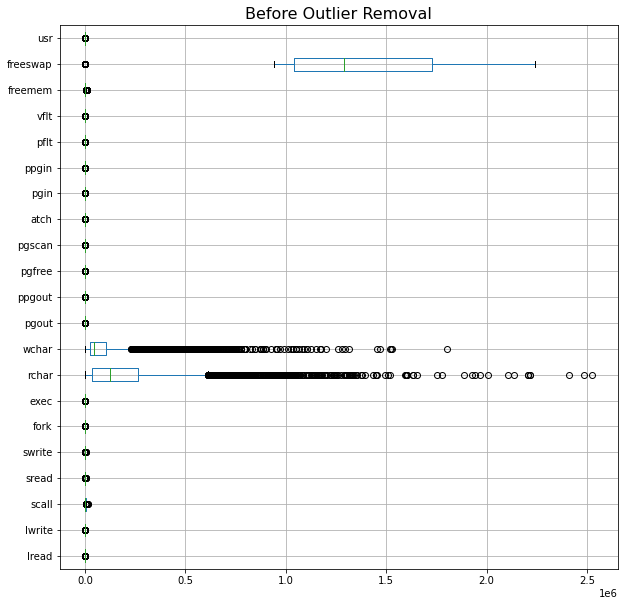

In [641]:
cont=df.dtypes[(df.dtypes!='uint8') & (df.dtypes!='object')].index
plt.figure(figsize=(10,10))
df[cont].boxplot(vert=0)
plt.title('Before Outlier Removal',fontsize=16)
plt.show()

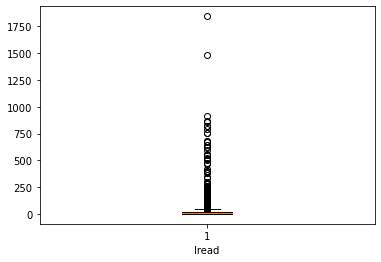

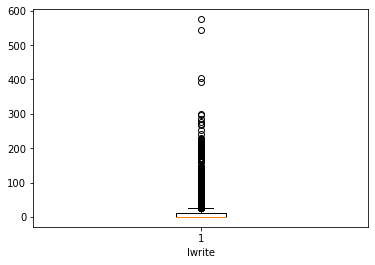

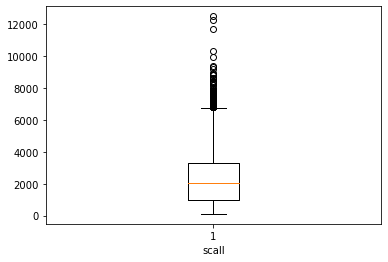

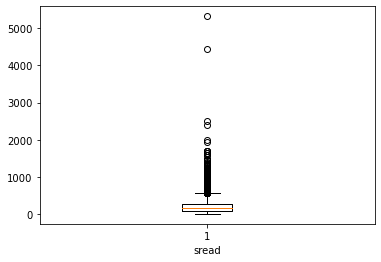

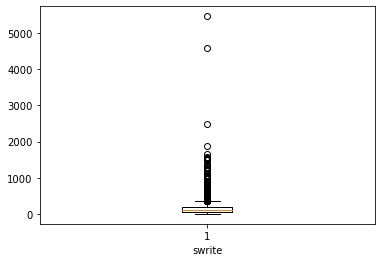

...

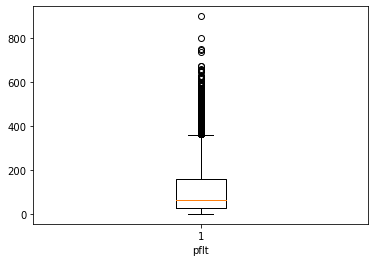

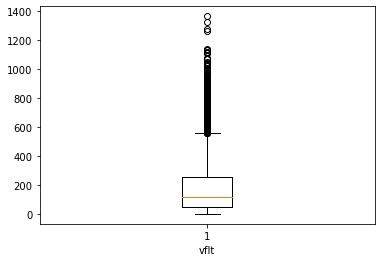

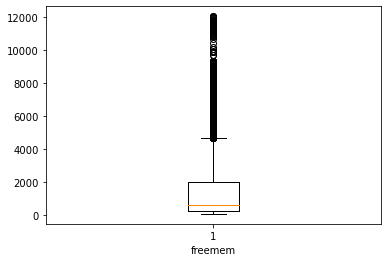

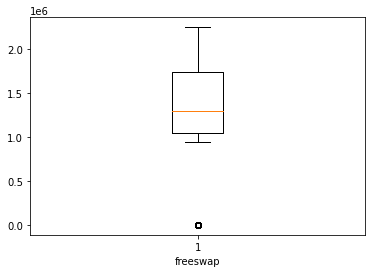

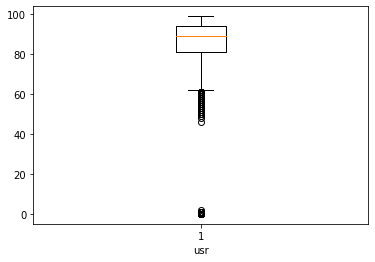

In [553]:
for col in df:
    if df[col].dtypes != 'object':
        plt.boxplot(df[col])
        plt.xlabel(col)
        plt.show()

In [554]:
def remove_outlier(col):
    sorted(col)
    Q1,Q3=np.percentile(col,[25,75])
    IQR=Q3-Q1
    lower_range= Q1-(1.5 * IQR)
    upper_range= Q3+(1.5 * IQR)
    return lower_range, upper_range

In [555]:
cont=df.dtypes[(df.dtypes!='object') & (df.dtypes!='bool')].index

In [556]:
for column in df[cont].columns:
    lr,ur=remove_outlier(df[column])
    df[column]=np.where(df[column]>ur,ur,df[column])
    df[column]=np.where(df[column]<lr,lr,df[column])

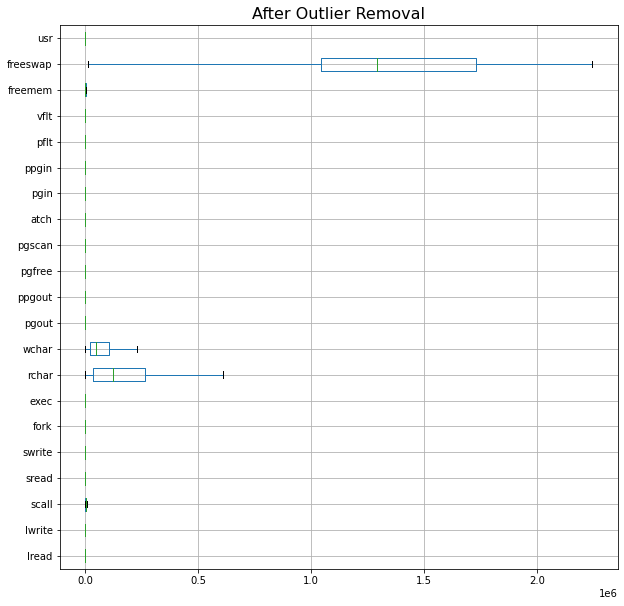

In [557]:
plt.figure(figsize=(10,10))
df[cont].boxplot(vert=0)
plt.title('After Outlier Removal',fontsize=16)
plt.show()

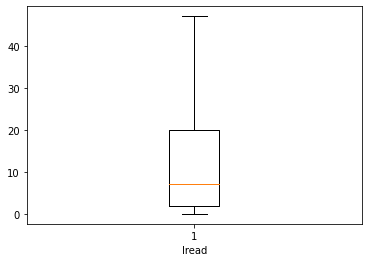

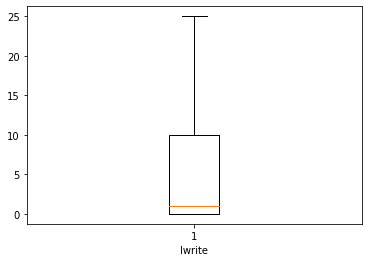

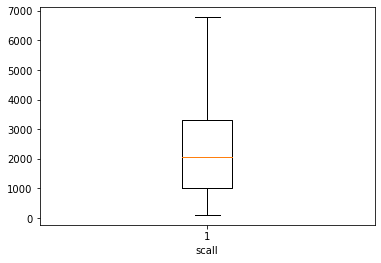

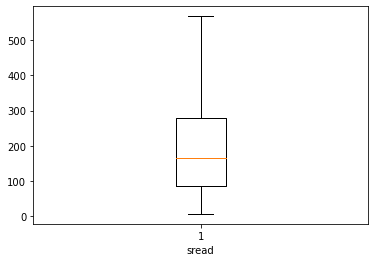

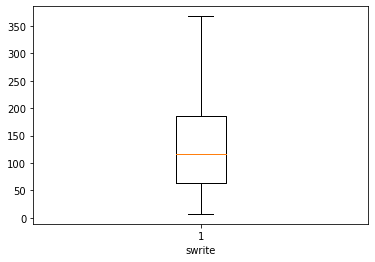

...

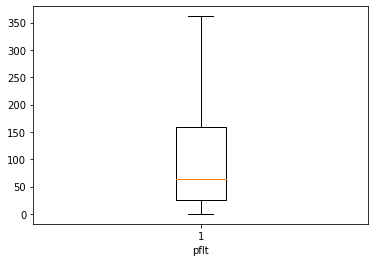

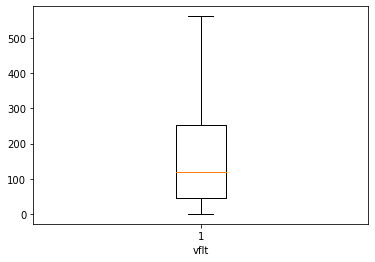

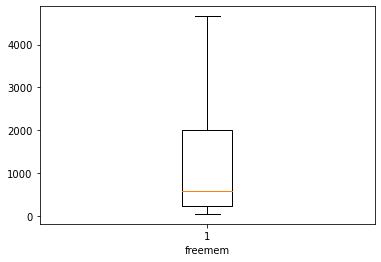

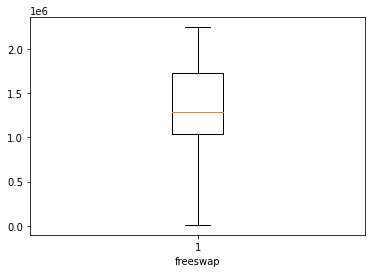

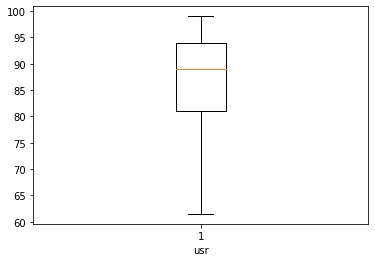

In [558]:
for col in df:
    if df[col].dtypes != 'object':
        plt.boxplot(df[col])
        plt.xlabel(col)
        plt.show()

df.describe()

In [559]:
df.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgscan,atch,pgin,ppgin,pflt,vflt,runqsz,freemem,freeswap,usr
0,1.0,0.0,2147.0,79.0,68.0,0.2,0.2,40671.0,53995.0,0.0,...,0.0,0.0,1.6,2.6,16.00,26.40,CPU_Bound,4659.125,1730946.0,95.0
1,0.0,0.0,170.0,18.0,21.0,0.2,0.2,448.0,8385.0,0.0,...,0.0,0.0,0.0,0.0,15.63,16.83,Not_CPU_Bound,4659.125,1869002.0,97.0
2,15.0,3.0,2162.0,159.0,119.0,2.0,2.4,125473.5,31950.0,0.0,...,0.0,1.2,6.0,9.4,150.20,220.20,Not_CPU_Bound,702.000,1021237.0,87.0
3,0.0,0.0,160.0,12.0,16.0,0.2,0.2,125473.5,8670.0,0.0,...,0.0,0.0,0.2,0.2,15.60,16.80,Not_CPU_Bound,4659.125,1863704.0,98.0
4,5.0,1.0,330.0,39.0,38.0,0.4,0.4,125473.5,12185.0,0.0,...,0.0,0.0,1.0,1.2,37.80,47.60,Not_CPU_Bound,633.000,1760253.0,90.0


In [560]:
df = df.drop('pgscan', axis=1)

### Univariate Analysis

<AxesSubplot:xlabel='lread', ylabel='Count'>

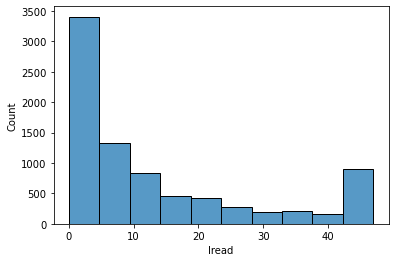

In [561]:
sns.histplot(df.lread,bins=10)

<AxesSubplot:xlabel='usr', ylabel='Count'>

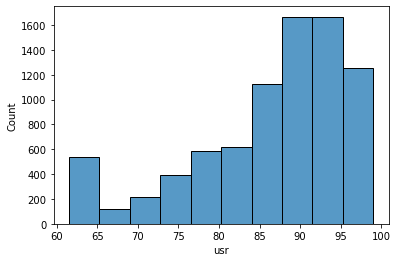

In [562]:
sns.histplot(df.usr,bins=10)

<AxesSubplot:xlabel='freeswap', ylabel='Count'>

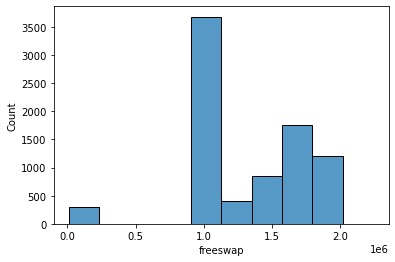

In [563]:
sns.histplot(df.freeswap,bins=10)

<AxesSubplot:xlabel='freemem', ylabel='Count'>

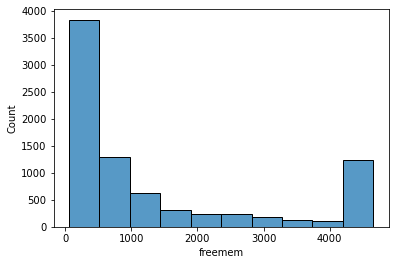

In [564]:
sns.histplot(df.freemem,bins=10)

In [565]:
### Bivariate Analysis

<AxesSubplot:xlabel='lread', ylabel='count'>

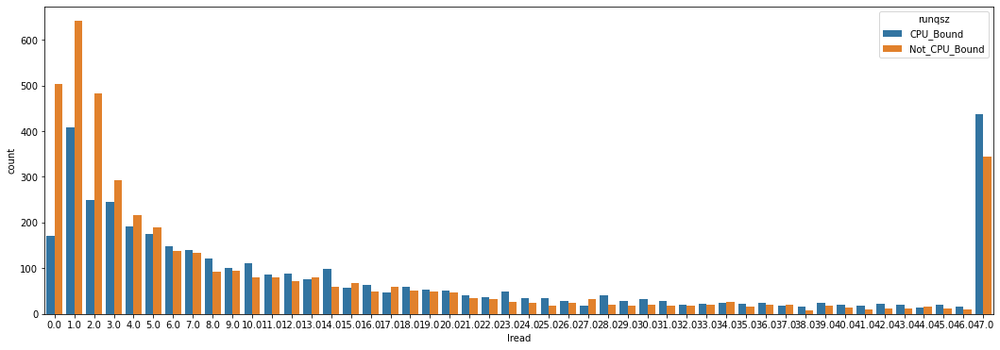

In [566]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df, x="lread", hue="runqsz", ax=ax)  

<AxesSubplot:xlabel='usr', ylabel='count'>

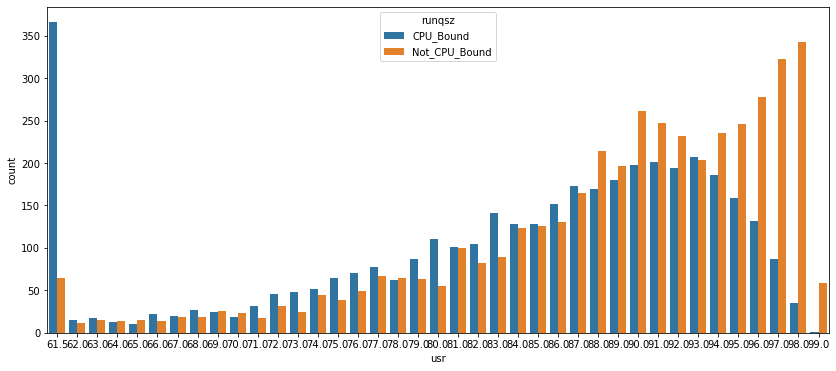

In [567]:
fig, ax = plt.subplots(figsize=(14,6)) 
sns.countplot(data=df, x="usr", hue="runqsz", ax=ax)  

<AxesSubplot:xlabel='fork', ylabel='vflt'>

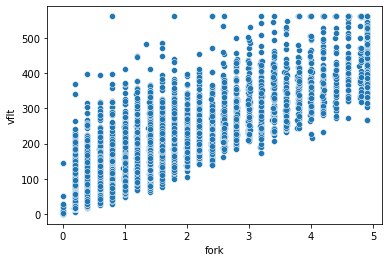

In [568]:
sns.scatterplot(x="fork",y="vflt",data=df)

<AxesSubplot:xlabel='fork', ylabel='pflt'>

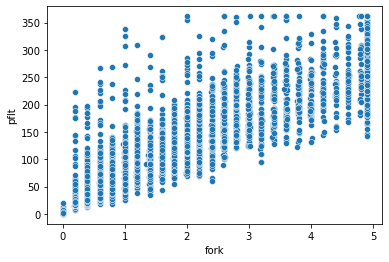

In [569]:
sns.scatterplot(x="fork",y="pflt",data=df)

<AxesSubplot:xlabel='exec', ylabel='vflt'>

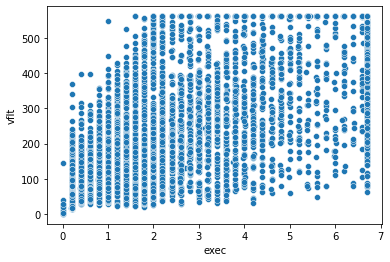

In [570]:
sns.scatterplot(x="exec",y="vflt",data=df)

<AxesSubplot:xlabel='pflt', ylabel='exec'>

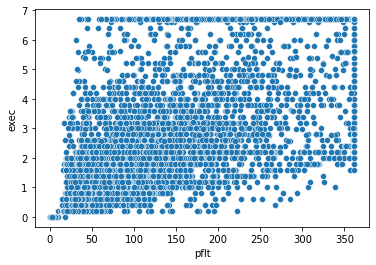

In [571]:
sns.scatterplot(x="pflt",y="exec",data=df)

<AxesSubplot:xlabel='lwrite', ylabel='lread'>

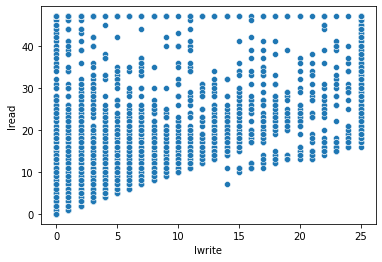

In [572]:
sns.scatterplot(x="lwrite",y="lread",data=df)

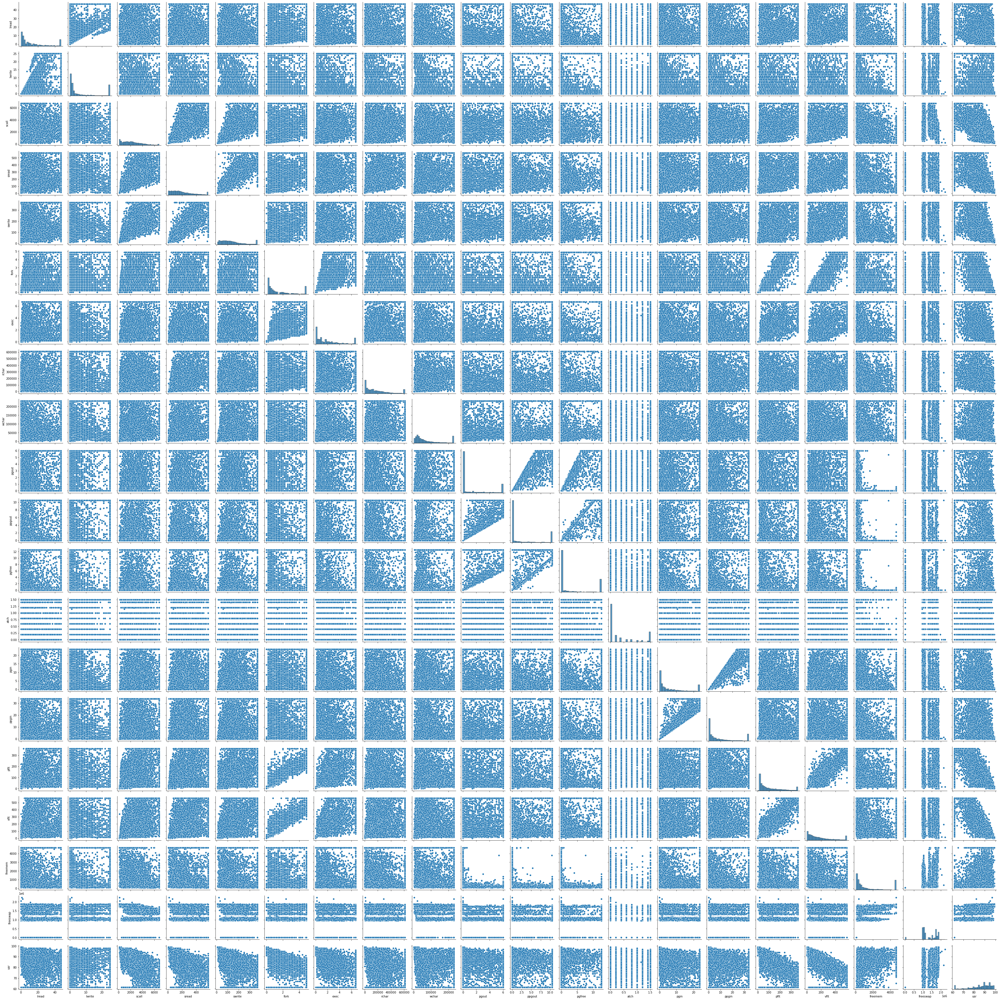

In [573]:
sns.pairplot(df)
plt.show()

In [574]:
df.corr()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr
lread,1.000000,0.834674,0.333572,0.326032,0.306542,0.365676,0.364062,0.255544,0.174410,0.208258,0.219798,0.214400,0.230628,0.283252,0.290564,0.375250,0.421079,-0.201369,-0.243903,-0.438163
lwrite,0.834674,1.000000,0.140213,0.148028,0.132097,0.093166,0.121778,0.117504,0.132595,0.090726,0.089149,0.082519,0.126769,0.113368,0.118388,0.102631,0.135243,-0.099558,-0.149630,-0.185695
scall,0.333572,0.140213,1.000000,0.763001,0.742206,0.474491,0.440010,0.386875,0.331933,0.297487,0.305507,0.300612,0.306359,0.335380,0.325487,0.485361,0.548081,-0.388969,-0.357864,-0.618932
sread,0.326032,0.148028,0.763001,1.000000,0.876652,0.528047,0.369723,0.576127,0.415059,0.301658,0.315648,0.311863,0.292044,0.346654,0.344586,0.529364,0.597892,-0.349887,-0.369897,-0.638072
swrite,0.306542,0.132097,0.742206,0.876652,1.000000,0.519148,0.313323,0.419759,0.430126,0.274708,0.284982,0.280082,0.264283,0.307420,0.302481,0.505560,0.563163,-0.350318,-0.336869,-0.598098
fork,0.365676,0.093166,0.474491,0.528047,0.519148,1.000000,0.774268,0.370995,0.122990,0.197047,0.214192,0.216166,0.201768,0.247715,0.236216,0.939125,0.932579,-0.136045,-0.133135,-0.673513
exec,0.364062,0.121778,0.440010,0.369723,0.313323,0.774268,1.000000,0.324990,0.124145,0.230712,0.248680,0.250468,0.252416,0.299591,0.288017,0.758255,0.763429,-0.191919,-0.184268,-0.609368
rchar,0.255544,0.117504,0.386875,0.576127,0.419759,0.370995,0.324990,1.000000,0.486317,0.250881,0.267983,0.261728,0.265281,0.369470,0.390376,0.381489,0.438870,-0.165552,-0.230327,-0.507561
wchar,0.174410,0.132595,0.331933,0.415059,0.430126,0.122990,0.124145,0.486317,1.000000,0.195926,0.204542,0.187786,0.160142,0.250258,0.260535,0.125757,0.157922,-0.146838,-0.175309,-0.317330
pgout,0.208258,0.090726,0.297487,0.301658,0.274708,0.197047,0.230712,0.250881,0.195926,1.000000,0.950418,0.909151,0.642940,0.437916,0.448769,0.206128,0.299740,-0.469831,-0.348040,-0.381960


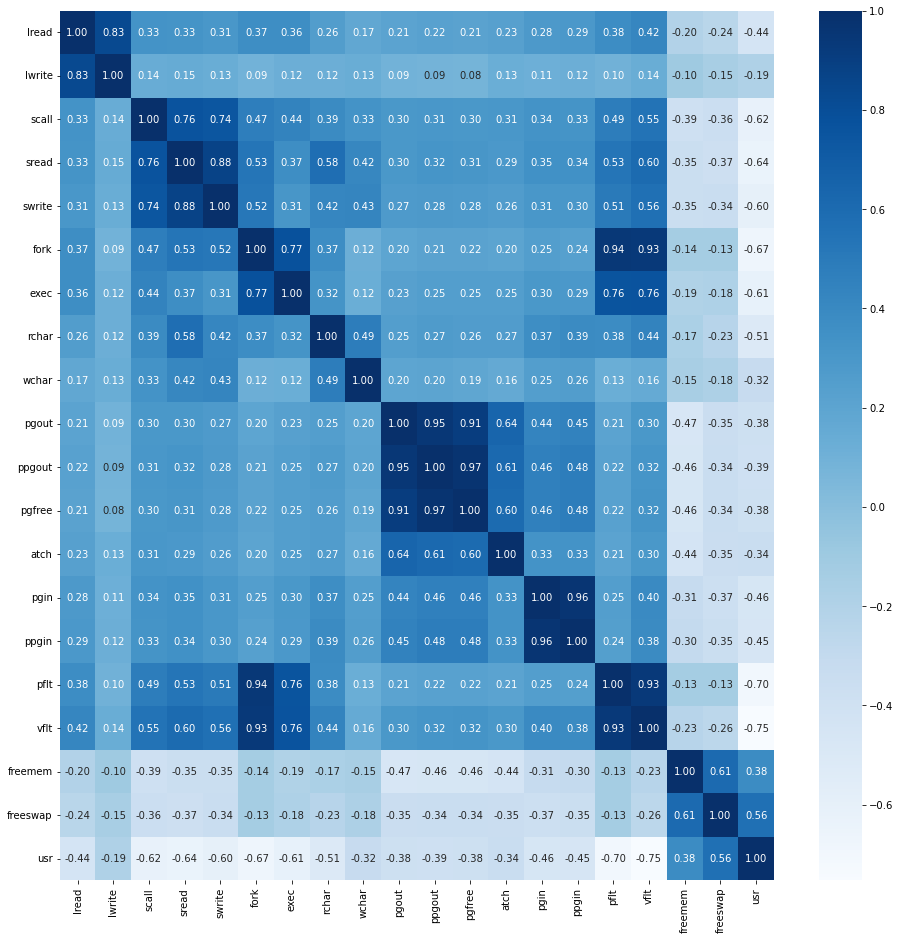

In [575]:
plt.figure(figsize=(16,16))
sns.heatmap(df.corr(), annot=True, fmt='.2f', cmap='Blues')
plt.show()

In [583]:
cat=[]
num=[]
for i in df.columns:
    if df[i].dtype=="object":
        cat.append(i)
    else:
        num.append(i)
print(cat) 
print(num)

['runqsz']
['lread', 'lwrite', 'scall', 'sread', 'swrite', 'fork', 'exec', 'rchar', 'wchar', 'pgout', 'ppgout', 'pgfree', 'atch', 'pgin', 'ppgin', 'pflt', 'vflt', 'freemem', 'freeswap', 'usr']


In [584]:
from scipy.stats import zscore
data_scaled=df[num].apply(zscore)

In [585]:
data_scaled.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr
0,-0.819513,-0.716521,-0.092583,-0.823008,-0.720331,-0.853341,-0.853740,-0.791696,-0.303831,-0.64583,-0.634297,-0.635071,-0.689780,-0.622761,-0.586048,-0.882744,-0.918365,2.037473,0.956433,0.898009
1,-0.885482,-0.716521,-1.333640,-1.238681,-1.204189,-0.853341,-0.853740,-1.022096,-0.943894,-0.64583,-0.634297,-0.635071,-0.689780,-0.830987,-0.819018,-0.886387,-0.977262,2.037473,1.284547,1.103180
2,0.104042,-0.393641,-0.083166,-0.277863,-0.195293,0.277935,0.231003,-0.305940,-0.613197,-0.64583,-0.634297,-0.635071,1.442029,-0.050138,0.023258,0.438869,0.274345,-0.427003,-0.730310,0.077327
3,-0.885482,-0.716521,-1.339918,-1.279567,-1.255663,-0.853341,-0.853740,-0.305940,-0.939894,-0.64583,-0.634297,-0.635071,-0.689780,-0.804959,-0.801097,-0.886683,-0.977446,2.037473,1.271955,1.205765
4,-0.555640,-0.608895,-1.233200,-1.095580,-1.029176,-0.727644,-0.755127,-0.305940,-0.890567,-0.64583,-0.634297,-0.635071,-0.689780,-0.700845,-0.711493,-0.668055,-0.787893,-0.469976,1.026087,0.385083


In [586]:
data_scaled['runqsz'] = df['runqsz']

In [587]:
data_scaled.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz
0,-0.819513,-0.716521,-0.092583,-0.823008,-0.720331,-0.853341,-0.853740,-0.791696,-0.303831,-0.64583,...,-0.635071,-0.689780,-0.622761,-0.586048,-0.882744,-0.918365,2.037473,0.956433,0.898009,CPU_Bound
1,-0.885482,-0.716521,-1.333640,-1.238681,-1.204189,-0.853341,-0.853740,-1.022096,-0.943894,-0.64583,...,-0.635071,-0.689780,-0.830987,-0.819018,-0.886387,-0.977262,2.037473,1.284547,1.103180,Not_CPU_Bound
2,0.104042,-0.393641,-0.083166,-0.277863,-0.195293,0.277935,0.231003,-0.305940,-0.613197,-0.64583,...,-0.635071,1.442029,-0.050138,0.023258,0.438869,0.274345,-0.427003,-0.730310,0.077327,Not_CPU_Bound
3,-0.885482,-0.716521,-1.339918,-1.279567,-1.255663,-0.853341,-0.853740,-0.305940,-0.939894,-0.64583,...,-0.635071,-0.689780,-0.804959,-0.801097,-0.886683,-0.977446,2.037473,1.271955,1.205765,Not_CPU_Bound
4,-0.555640,-0.608895,-1.233200,-1.095580,-1.029176,-0.727644,-0.755127,-0.305940,-0.890567,-0.64583,...,-0.635071,-0.689780,-0.700845,-0.711493,-0.668055,-0.787893,-0.469976,1.026087,0.385083,Not_CPU_Bound


In [588]:
data_scaled = pd.get_dummies(data_scaled, columns=['runqsz'],drop_first=True)

In [589]:
data_scaled.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,...,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,usr,runqsz_Not_CPU_Bound
0,-0.819513,-0.716521,-0.092583,-0.823008,-0.720331,-0.853341,-0.853740,-0.791696,-0.303831,-0.64583,...,-0.635071,-0.689780,-0.622761,-0.586048,-0.882744,-0.918365,2.037473,0.956433,0.898009,0
1,-0.885482,-0.716521,-1.333640,-1.238681,-1.204189,-0.853341,-0.853740,-1.022096,-0.943894,-0.64583,...,-0.635071,-0.689780,-0.830987,-0.819018,-0.886387,-0.977262,2.037473,1.284547,1.103180,1
2,0.104042,-0.393641,-0.083166,-0.277863,-0.195293,0.277935,0.231003,-0.305940,-0.613197,-0.64583,...,-0.635071,1.442029,-0.050138,0.023258,0.438869,0.274345,-0.427003,-0.730310,0.077327,1
3,-0.885482,-0.716521,-1.339918,-1.279567,-1.255663,-0.853341,-0.853740,-0.305940,-0.939894,-0.64583,...,-0.635071,-0.689780,-0.804959,-0.801097,-0.886683,-0.977446,2.037473,1.271955,1.205765,1
4,-0.555640,-0.608895,-1.233200,-1.095580,-1.029176,-0.727644,-0.755127,-0.305940,-0.890567,-0.64583,...,-0.635071,-0.689780,-0.700845,-0.711493,-0.668055,-0.787893,-0.469976,1.026087,0.385083,1


In [590]:
# Are there any duplicates ?
dups = data_scaled.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))
#df[dups]

Number of duplicate rows = 0


In [591]:
# data_scaled = data_scaled.drop('pgscan', axis=1)

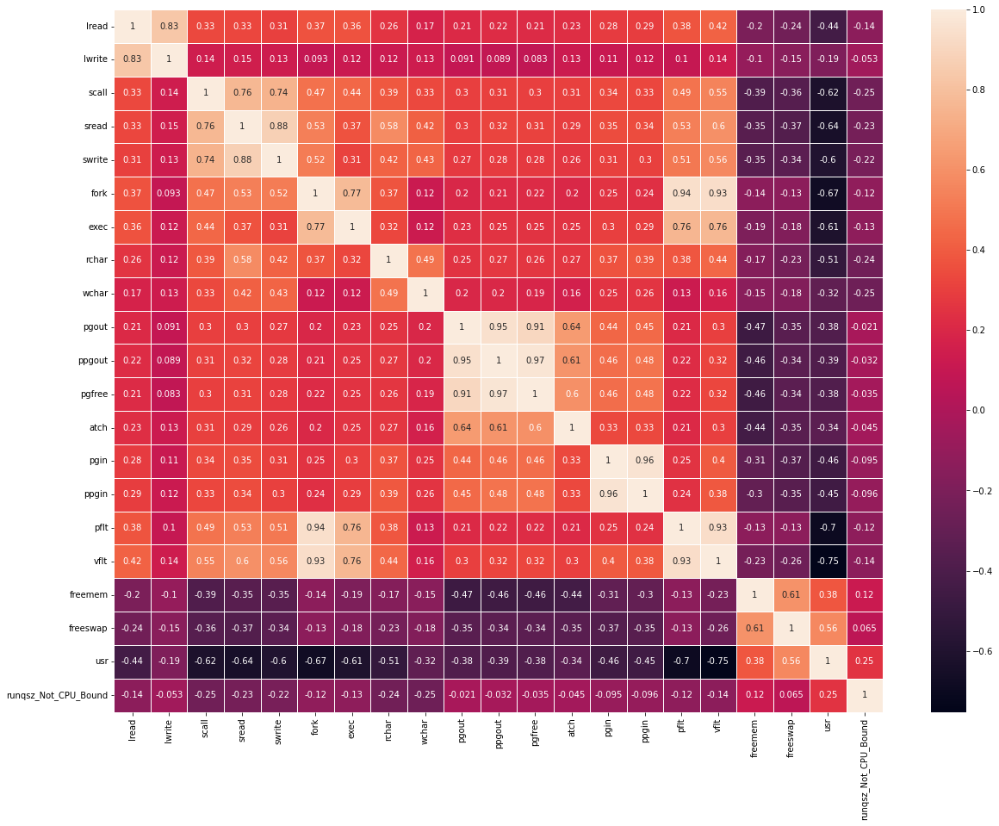

In [592]:
fig, ax = plt.subplots(figsize=(20,15)) 
sns.heatmap(data_scaled.iloc[:, 0:21].corr(),annot=True, linewidths=.5, ax=ax)
plt.show()

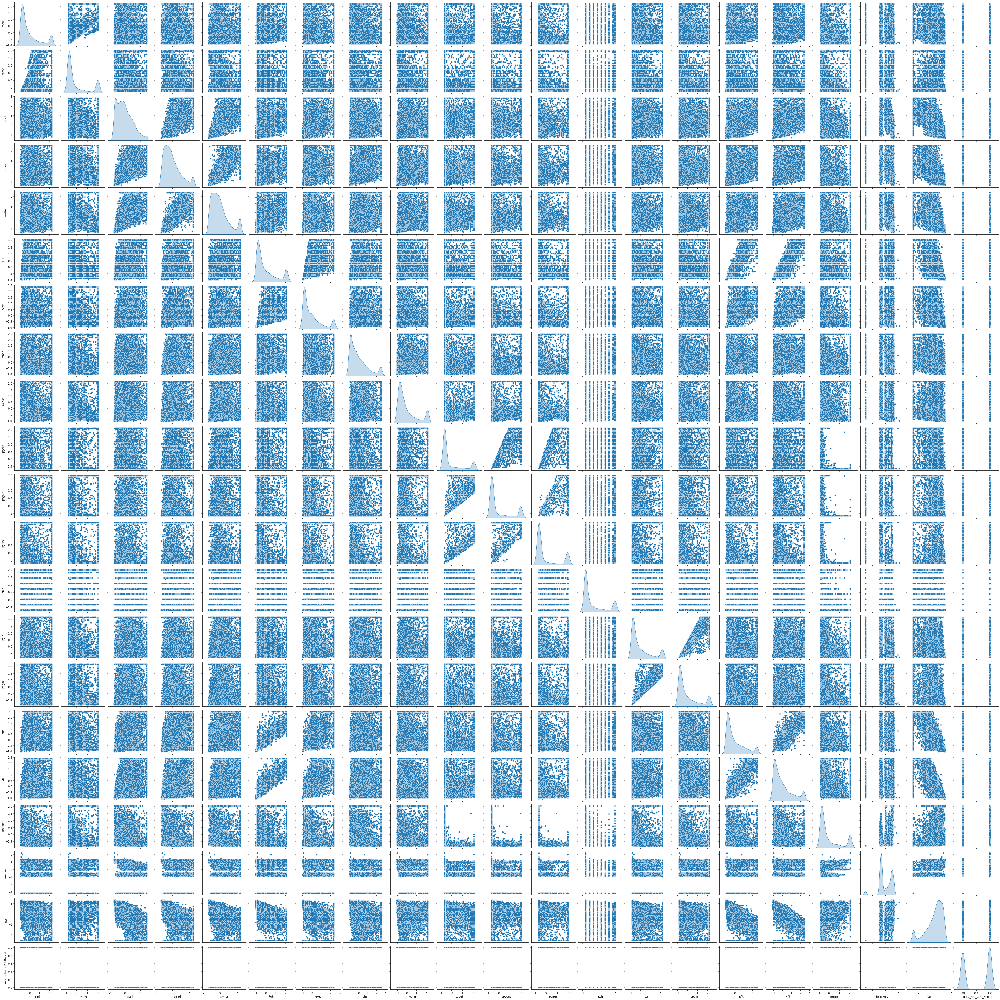

In [593]:
sns.pairplot(data_scaled, diag_kind='kde')  
plt.show()

In [594]:
data_scaled.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8192 entries, 0 to 8191
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   lread                 8192 non-null   float64
 1   lwrite                8192 non-null   float64
 2   scall                 8192 non-null   float64
 3   sread                 8192 non-null   float64
 4   swrite                8192 non-null   float64
 5   fork                  8192 non-null   float64
 6   exec                  8192 non-null   float64
 7   rchar                 8192 non-null   float64
 8   wchar                 8192 non-null   float64
 9   pgout                 8192 non-null   float64
 10  ppgout                8192 non-null   float64
 11  pgfree                8192 non-null   float64
 12  atch                  8192 non-null   float64
 13  pgin                  8192 non-null   float64
 14  ppgin                 8192 non-null   float64
 15  pflt                 

In [599]:
# Copy all the predictor variables into X dataframe
X = data_scaled.drop('usr', axis=1)

# Copy target into the y dataframe. 
y = data_scaled[['usr']]

In [600]:
X.head()

,lread,lwrite,scall,sread,swrite,fork,exec,rchar,wchar,pgout,ppgout,pgfree,atch,pgin,ppgin,pflt,vflt,freemem,freeswap,runqsz_Not_CPU_Bound
0,-0.819513,-0.716521,-0.092583,-0.823008,-0.720331,-0.853341,-0.853740,-0.791696,-0.303831,-0.64583,-0.634297,-0.635071,-0.689780,-0.622761,-0.586048,-0.882744,-0.918365,2.037473,0.956433,0
1,-0.885482,-0.716521,-1.333640,-1.238681,-1.204189,-0.853341,-0.853740,-1.022096,-0.943894,-0.64583,-0.634297,-0.635071,-0.689780,-0.830987,-0.819018,-0.886387,-0.977262,2.037473,1.284547,1
2,0.104042,-0.393641,-0.083166,-0.277863,-0.195293,0.277935,0.231003,-0.305940,-0.613197,-0.64583,-0.634297,-0.635071,1.442029,-0.050138,0.023258,0.438869,0.274345,-0.427003,-0.730310,1
3,-0.885482,-0.716521,-1.339918,-1.279567,-1.255663,-0.853341,-0.853740,-0.305940,-0.939894,-0.64583,-0.634297,-0.635071,-0.689780,-0.804959,-0.801097,-0.886683,-0.977446,2.037473,1.271955,1
4,-0.555640,-0.608895,-1.233200,-1.095580,-1.029176,-0.727644,-0.755127,-0.305940,-0.890567,-0.64583,-0.634297,-0.635071,-0.689780,-0.700845,-0.711493,-0.668055,-0.787893,-0.469976,1.026087,1


In [601]:
y.head()

,usr
0,0.898009
1,1.103180
2,0.077327
3,1.205765
4,0.385083


In [602]:
# Split X and y into training and test set in 70:30 ratio
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30 , random_state=1)

In [603]:
# invoke the LinearRegression function and find the bestfit model on training data

regression_model = LinearRegression()
regression_model.fit(X_train, y_train)

LinearRegression()

In [604]:
# Let us explore the coefficients for each of the independent attributes

for idx, col_name in enumerate(X_train.columns):
    print("The coefficient for {} is {}".format(col_name, regression_model.coef_[0][idx]))

The coefficient for lread is -0.09871824976719683
The coefficient for lwrite is 0.04590533188445586
The coefficient for scall is -0.10848139452971808
The coefficient for sread is 0.004640545382811098
The coefficient for swrite is -0.054026895749822265
The coefficient for fork is 0.0047845913214960845
The coefficient for exec is -0.06682067872604344
The coefficient for rchar is -0.09253392891234861
The coefficient for wchar is -0.03949546382627736
The coefficient for pgout is -0.08324229431102115
The coefficient for ppgout is -0.03172246444169935
The coefficient for pgfree is 0.04318715433743629
The coefficient for atch is 0.03623956018972239
The coefficient for pgin is 0.015755668510964695
The coefficient for ppgin is -0.07708893932684222
The coefficient for pflt is -0.35003302788246593
The coefficient for vflt is -0.09107270355084014
The coefficient for freemem is -0.07551761281307513
The coefficient for freeswap is 0.38121285779229763
The coefficient for runqsz_Not_CPU_Bound is 0.165

In [605]:
# Let us check the intercept for the model

intercept = regression_model.intercept_[0]

print("The intercept for our model is {}".format(intercept))

The intercept for our model is -0.09051228888146508


In [606]:
# R square on training data
regression_model.score(X_train, y_train)

0.7961086101274572

In [607]:
# R square on testing data
regression_model.score(X_test, y_test)

0.7677318597936169

In [608]:
#RMSE on Training data
predicted_train=regression_model.fit(X_train, y_train).predict(X_train)
np.sqrt(metrics.mean_squared_error(y_train,predicted_train))

0.45337923791490436

In [609]:
#RMSE on Testing data
predicted_test=regression_model.fit(X_train, y_train).predict(X_test)
np.sqrt(metrics.mean_squared_error(y_test,predicted_test))

0.4772569420288289

In [610]:
import statsmodels.api as sm

In [611]:
X_train=sm.add_constant(X_train)# This adds the constant term beta0 to the Simple Linear Regression.
X_test=sm.add_constant(X_test)

In [612]:
model = sm.OLS(y_train,X_train).fit()
model

In [613]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                    usr   R-squared:                       0.796
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     1115.
Date:                Sun, 30 Apr 2023   Prob (F-statistic):               0.00
Time:                        02:54:16   Log-Likelihood:                -3600.4
No. Observations:                5734   AIC:                             7243.
Df Residuals:                    5713   BIC:                             7383.
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.0905      0.009     -9.935      0.000      -0.108      -0.073
lread                   -0.0987      0.014     -7.071      0.000      -0.126      -0.071
lwrite                   0.0459      0.013      3.671      0.000       0.021       0.070
scall                   -0.1085      0.010    -10.566      0.000      -0.129      -0.088
sread                    0.0046      0.015      0.305      0.760      -0.025       0.034
swrite                  -0.0540      0.014     -3.777      0.000      -0.082      -0.026
fork                     0.0048      0.022      0.222      0.824      -0.037       0.047
exec                    -0.0668      0.011     -6.220      0.000      -0.088      -0.046
rchar                   -0.0925      0.009    -10.598      0.000      -0.110      -0.075
wchar                   -0.0395      0.008     -5.232      0.000      -0.054      -0.025
pgout                   -0.0832      0.020     -4.098      0.000      -0.123      -0.043
ppgout                  -0.0317      0.033     -0.973      0.330      -0.096       0.032
pgfree                   0.0432      0.024      1.769      0.077      -0.005       0.091
atch                     0.0362      0.008      4.394      0.000       0.020       0.052
pgin                     0.0158      0.022      0.703      0.482      -0.028       0.060
ppgin                   -0.0771      0.023     -3.415      0.001      -0.121      -0.033
pflt                    -0.3500      0.021    -16.957      0.000      -0.390      -0.310
vflt                    -0.0911      0.024     -3.830      0.000      -0.138      -0.044
freemem                 -0.0755      0.008     -9.038      0.000      -0.092      -0.059
freeswap                 0.3812      0.008     46.472      0.000       0.365       0.397
runqsz_Not_CPU_Bound     0.1657      0.013     12.819      0.000       0.140       0.191
==============================================================================
Omnibus:                     1103.645   Durbin-Watson:                   2.016
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2372.553
Skew:                          -1.119   Prob(JB):                         0.00
Kurtosis:                       5.219   Cond. No.                         18.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [620]:
#Calculate MSE on train
predicted_train=model.predict(X_train)
mse=metrics.mean_squared_error(y_train,predicted_train)


In [621]:
np.sqrt(mse) #RMSE on train 

0.45337923791490436

In [622]:
# Prediction on Test data
y_pred = model.predict(X_test)

In [624]:
#Calculate MSE on test
mse=metrics.mean_squared_error(y_test,y_pred)
np.sqrt(mse) #RMSE on test

0.4772569420288292

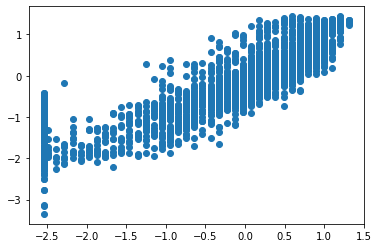

In [625]:
plt.scatter(y_test, y_pred)
plt.show()

In [626]:
for i,j in np.array(model.params.reset_index()):
    print('({}) * {} +'.format(round(j,2),i),end=' ')

(-0.09) * const + (-0.1) * lread + (0.05) * lwrite + (-0.11) * scall + (0.0) * sread + (-0.05) * swrite + (0.0) * fork + (-0.07) * exec + (-0.09) * rchar + (-0.04) * wchar + (-0.08) * pgout + (-0.03) * ppgout + (0.04) * pgfree + (0.04) * atch + (0.02) * pgin + (-0.08) * ppgin + (-0.35) * pflt + (-0.09) * vflt + (-0.08) * freemem + (0.38) * freeswap + (0.17) * runqsz_Not_CPU_Bound + 

## Problem 2

In [497]:
import pandas as pd
from sklearn.linear_model import LogisticRegression

# importing ploting libraries
import matplotlib.pyplot as plt   

#importing seaborn for statistical plots
import seaborn as sns

#Let us break the X and y dataframes into training set and test set. For this we will use
#Sklearn package's data splitting function which is based on random function

from sklearn.model_selection import train_test_split

import numpy as np


# calculate accuracy measures and confusion matrix
from sklearn import metrics
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import confusion_matrix

In [498]:
df1 = pd.read_excel("Contraceptive_method_dataset.xlsx");

In [499]:
df1.head()

,Wife_age,Wife_education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,24.0,Primary,Secondary,3.0,Scientology,No,2,High,Exposed,No
1,45.0,Uneducated,Secondary,10.0,Scientology,No,3,Very High,Exposed,No
2,43.0,Primary,Secondary,7.0,Scientology,No,3,Very High,Exposed,No
3,42.0,Secondary,Primary,9.0,Scientology,No,3,High,Exposed,No
4,36.0,Secondary,Secondary,8.0,Scientology,No,3,Low,Exposed,No


In [500]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1473 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1402 non-null   float64
 1   Wife_education             1473 non-null   object 
 2   Husband_education          1473 non-null   object 
 3   No_of_children_born        1452 non-null   float64
 4   Wife_religion              1473 non-null   object 
 5   Wife_Working               1473 non-null   object 
 6   Husband_Occupation         1473 non-null   int64  
 7   Standard_of_living_index   1473 non-null   object 
 8   Media_exposure             1473 non-null   object 
 9   Contraceptive_method_used  1473 non-null   object 
dtypes: float64(2), int64(1), object(7)
memory usage: 115.2+ KB


In [501]:
df1.describe()

,Wife_age,No_of_children_born,Husband_Occupation
count,1402.000000,1452.000000,1473.000000
mean,32.606277,3.254132,2.137814
std,8.274927,2.365212,0.864857
min,16.000000,0.000000,1.000000
25%,26.000000,1.000000,1.000000
50%,32.000000,3.000000,2.000000
75%,39.000000,4.000000,3.000000
max,49.000000,16.000000,4.000000


In [502]:
df1.isnull().sum()

Wife_age                     71
Wife_education                0
Husband_education             0
No_of_children_born          21
Wife_religion                 0
Wife_Working                  0
Husband_Occupation            0
Standard_of_living_index      0
Media_exposure                0
Contraceptive_method_used     0
dtype: int64

In [503]:
for column in df1.columns:
    if df1[column].dtype != 'object':
        median = df1[column].median()
        df1[column] = df1[column].fillna(median)    
        
df1.isnull().sum()

Wife_age                     0
Wife_education               0
Husband_education            0
No_of_children_born          0
Wife_religion                0
Wife_Working                 0
Husband_Occupation           0
Standard_of_living_index     0
Media_exposure               0
Contraceptive_method_used    0
dtype: int64

In [504]:
# Are there any duplicates ?
dups = df1.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))
#df[dups]

Number of duplicate rows = 85


In [505]:
print('Before',df1.shape)
df1.drop_duplicates(inplace=True) 
print('After',df1.shape)

Before (1473, 10)
After (1388, 10)


In [506]:
dups = df.duplicated()
print('Number of duplicate rows = %d' % (dups.sum()))

Number of duplicate rows = 0


In [507]:
cont=df1.dtypes[(df1.dtypes!='uint8') & (df1.dtypes!='object')].index

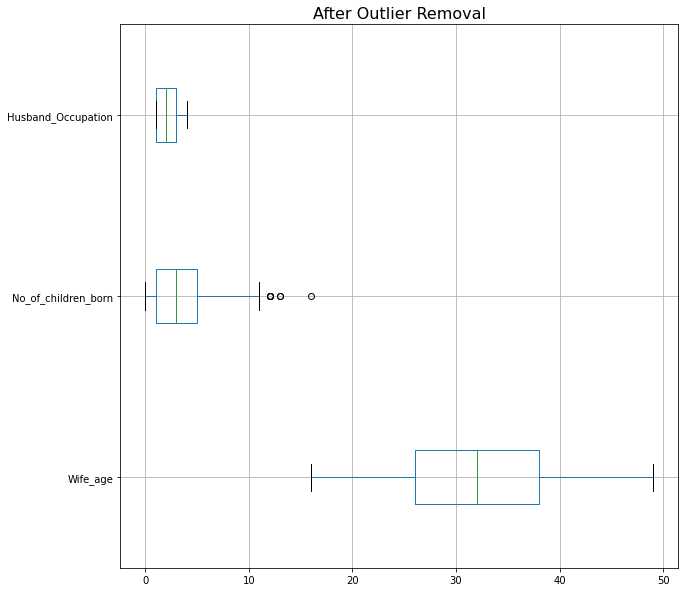

In [508]:
plt.figure(figsize=(10,10))
df1[cont].boxplot(vert=0)
plt.title('After Outlier Removal',fontsize=16)
plt.show()

In [509]:
for column in df1[cont].columns:
    lr,ur=remove_outlier(df1[column])
    df1[column]=np.where(df1[column]>ur,ur,df1[column])
    df1[column]=np.where(df1[column]<lr,lr,df1[column])

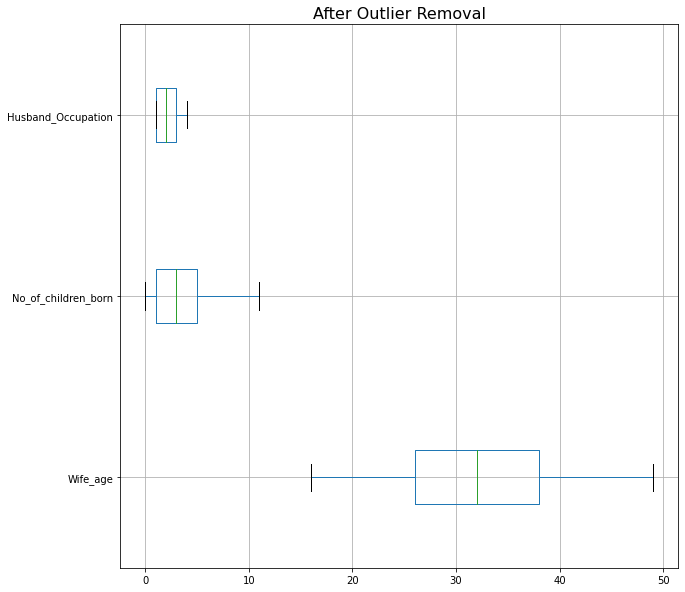

In [510]:
cont=df1.dtypes[(df1.dtypes!='uint8') & (df1.dtypes!='object')].index
plt.figure(figsize=(10,10))
df1[cont].boxplot(vert=0)
plt.title('After Outlier Removal',fontsize=16)
plt.show()

In [511]:
df1.head()

,Wife_age,Wife_education,Husband_education,No_of_children_born,Wife_religion,Wife_Working,Husband_Occupation,Standard_of_living_index,Media_exposure,Contraceptive_method_used
0,24.0,Primary,Secondary,3.0,Scientology,No,2.0,High,Exposed,No
1,45.0,Uneducated,Secondary,10.0,Scientology,No,3.0,Very High,Exposed,No
2,43.0,Primary,Secondary,7.0,Scientology,No,3.0,Very High,Exposed,No
3,42.0,Secondary,Primary,9.0,Scientology,No,3.0,High,Exposed,No
4,36.0,Secondary,Secondary,8.0,Scientology,No,3.0,Low,Exposed,No


### Univariate Analysis

<AxesSubplot:xlabel='Wife_age', ylabel='Count'>

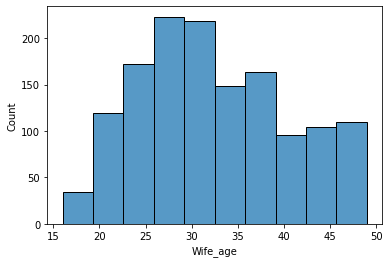

In [513]:
sns.histplot(df1.Wife_age,bins=10)

<AxesSubplot:xlabel='No_of_children_born', ylabel='Count'>

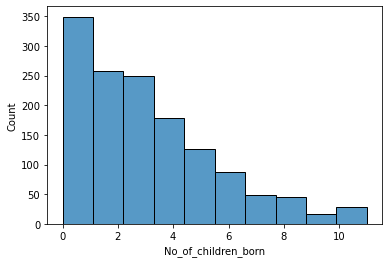

In [514]:
sns.histplot(df1.No_of_children_born,bins=10)

<AxesSubplot:xlabel='Husband_Occupation', ylabel='Count'>

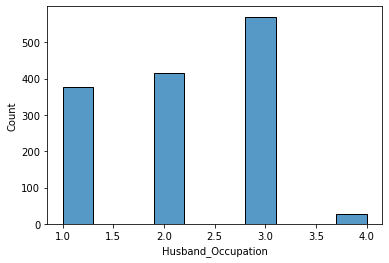

In [515]:
sns.histplot(df1.Husband_Occupation,bins=10)

### Bivariate Analysis

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

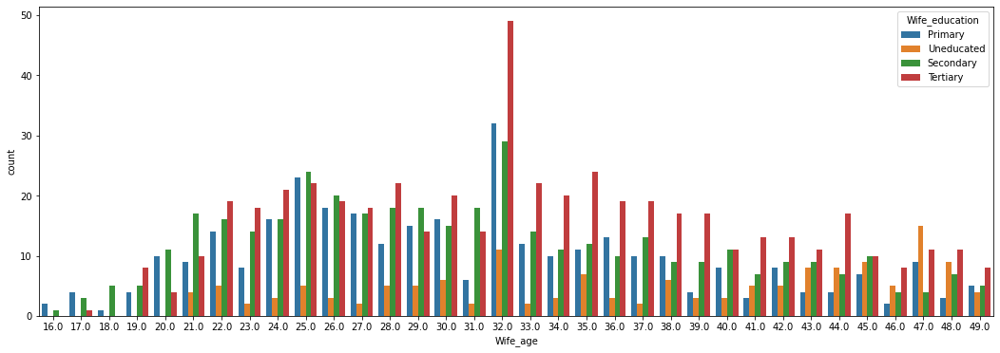

In [516]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Wife_education", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

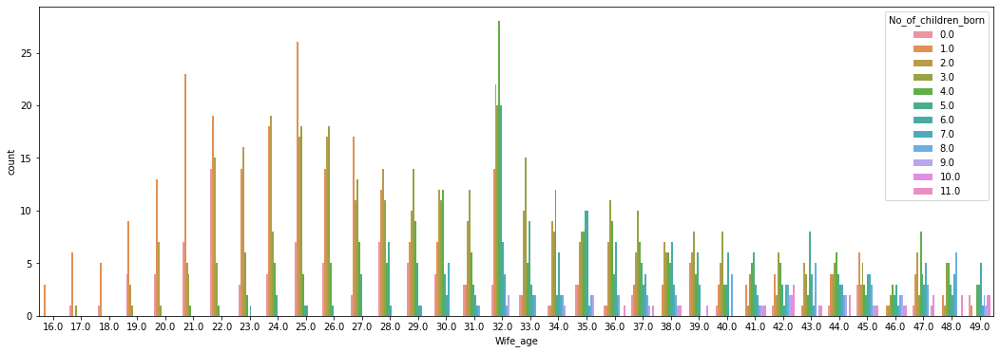

In [517]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="No_of_children_born", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

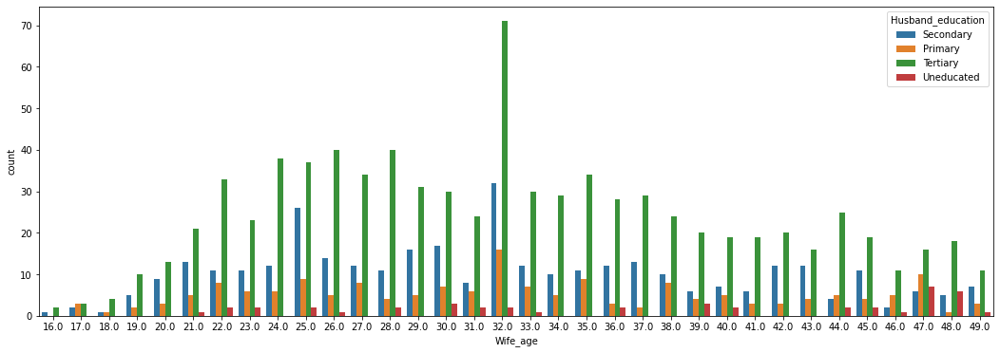

In [518]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Husband_education", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

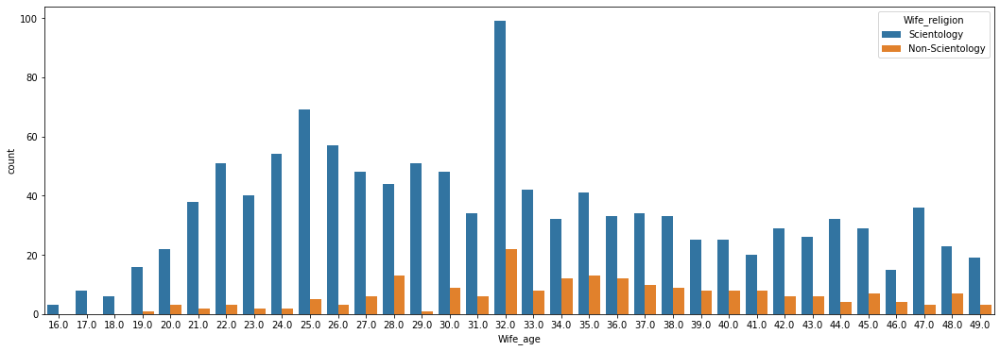

In [519]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Wife_religion", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

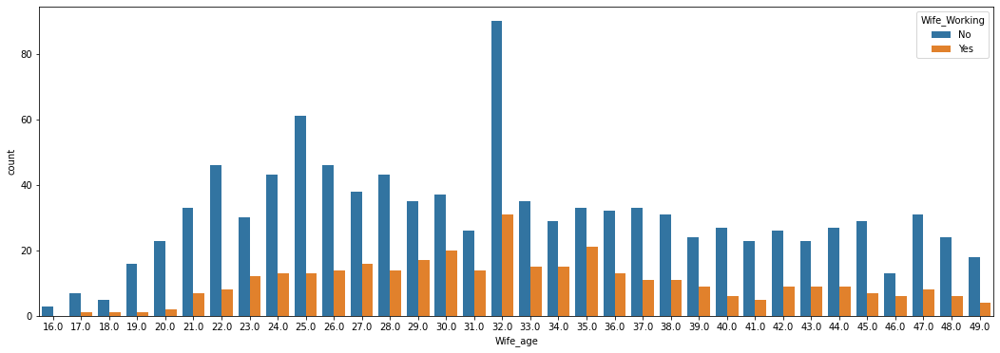

In [520]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Wife_Working", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

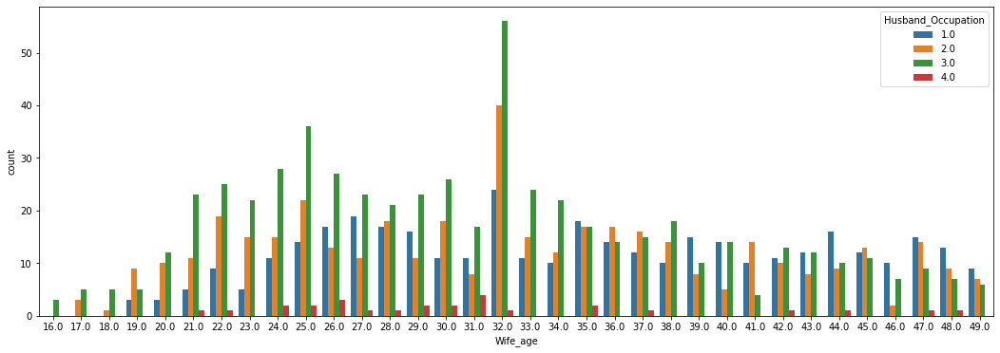

In [521]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Husband_Occupation", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

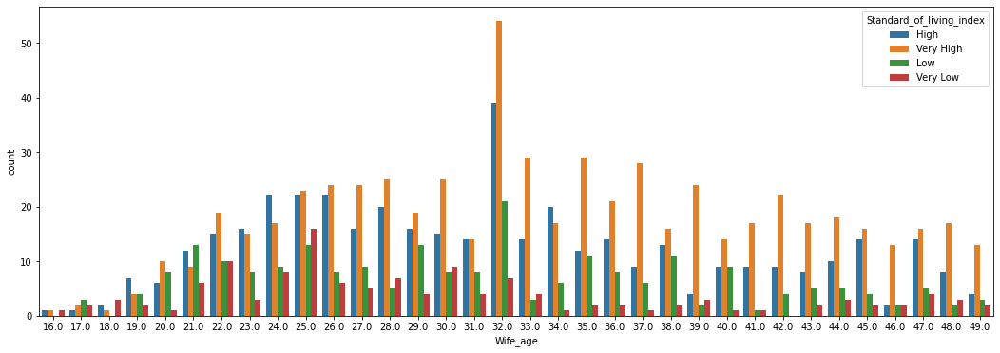

In [522]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Standard_of_living_index", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

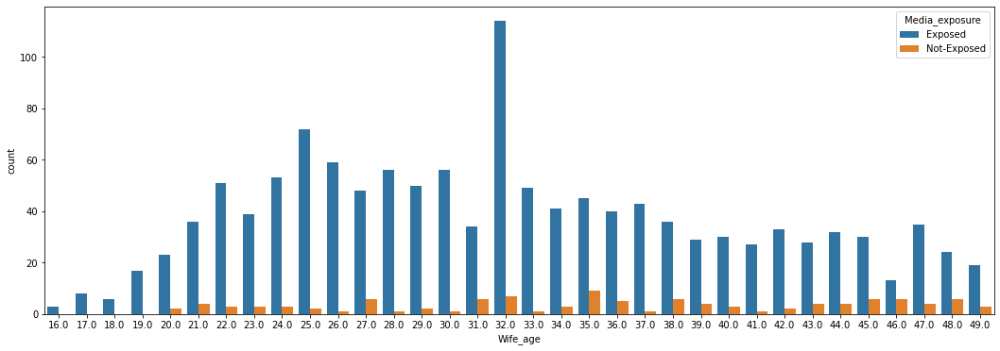

In [523]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Media_exposure", ax=ax)

<AxesSubplot:xlabel='Wife_age', ylabel='count'>

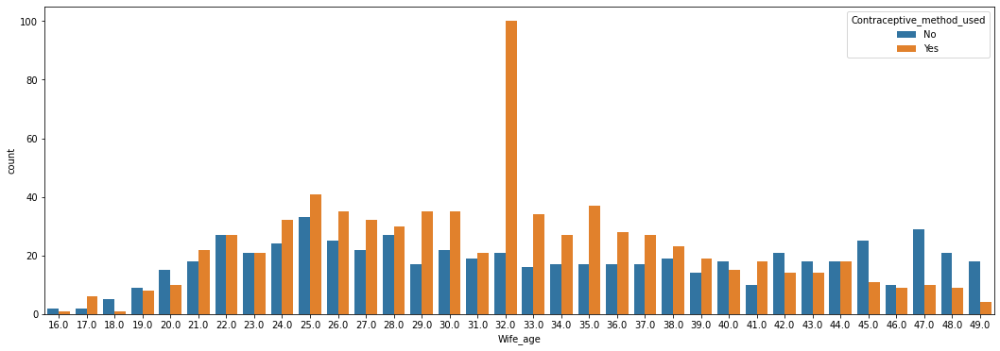

In [524]:
fig, ax = plt.subplots(figsize=(18,6)) 
sns.countplot(data=df1, x="Wife_age", hue="Contraceptive_method_used", ax=ax)

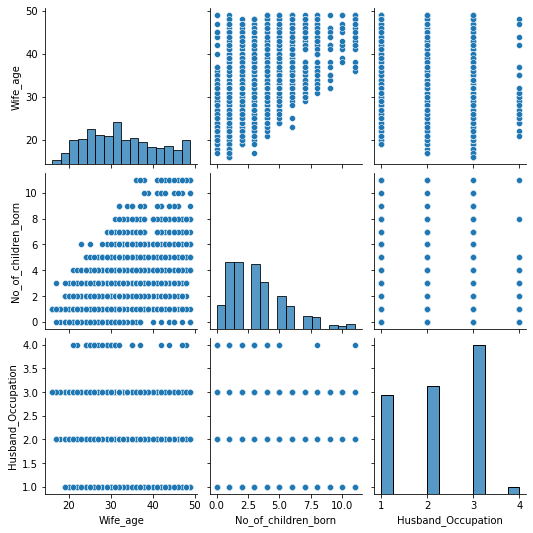

In [526]:
sns.pairplot(df1)
plt.show()

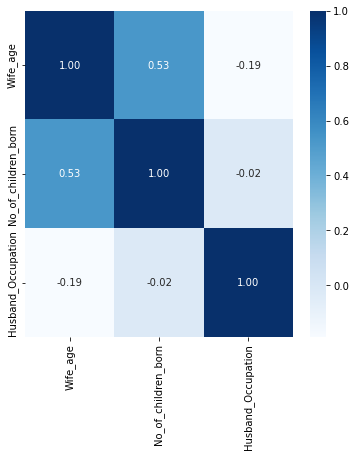

In [530]:
plt.figure(figsize=(6,6))
sns.heatmap(df1.corr(), annot=True, fmt='.2f', cmap='Blues')
plt.show()

In [456]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1388 entries, 0 to 1472
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Wife_age                   1388 non-null   float64
 1   Wife_education             1388 non-null   object 
 2   Husband_education          1388 non-null   object 
 3   No_of_children_born        1388 non-null   float64
 4   Wife_religion              1388 non-null   object 
 5   Wife_Working               1388 non-null   object 
 6   Husband_Occupation         1388 non-null   float64
 7   Standard_of_living_index   1388 non-null   object 
 8   Media_exposure             1388 non-null   object 
 9   Contraceptive_method_used  1388 non-null   object 
dtypes: float64(3), object(7)
memory usage: 119.3+ KB


In [457]:
df1 = pd.get_dummies(df1, columns=['Wife_education','Husband_education','Wife_religion','Wife_Working','Standard_of_living_index','Media_exposure','Contraceptive_method_used'],drop_first=True)

In [458]:
df1.head()

,Wife_age,No_of_children_born,Husband_Occupation,Wife_education_Secondary,Wife_education_Tertiary,Wife_education_Uneducated,Husband_education_Secondary,Husband_education_Tertiary,Husband_education_Uneducated,Wife_religion_Scientology,Wife_Working_Yes,Standard_of_living_index_Low,Standard_of_living_index_Very High,Standard_of_living_index_Very Low,Media_exposure_Not-Exposed,Contraceptive_method_used_Yes
0,24.0,3.0,2.0,0,0,0,1,0,0,1,0,0,0,0,0,0
1,45.0,10.0,3.0,0,0,1,1,0,0,1,0,0,1,0,0,0
2,43.0,7.0,3.0,0,0,0,1,0,0,1,0,0,1,0,0,0
3,42.0,9.0,3.0,1,0,0,0,0,0,1,0,0,0,0,0,0
4,36.0,8.0,3.0,1,0,0,1,0,0,1,0,1,0,0,0,0


In [459]:
# Copy all the predictor variables into X dataframe
X = df1.drop('Contraceptive_method_used_Yes', axis=1)

# Copy target into the y dataframe. 
y = df1[['Contraceptive_method_used_Yes']]

In [460]:
X.head()

,Wife_age,No_of_children_born,Husband_Occupation,Wife_education_Secondary,Wife_education_Tertiary,Wife_education_Uneducated,Husband_education_Secondary,Husband_education_Tertiary,Husband_education_Uneducated,Wife_religion_Scientology,Wife_Working_Yes,Standard_of_living_index_Low,Standard_of_living_index_Very High,Standard_of_living_index_Very Low,Media_exposure_Not-Exposed
0,24.0,3.0,2.0,0,0,0,1,0,0,1,0,0,0,0,0
1,45.0,10.0,3.0,0,0,1,1,0,0,1,0,0,1,0,0
2,43.0,7.0,3.0,0,0,0,1,0,0,1,0,0,1,0,0
3,42.0,9.0,3.0,1,0,0,0,0,0,1,0,0,0,0,0
4,36.0,8.0,3.0,1,0,0,1,0,0,1,0,1,0,0,0


In [461]:
y.head()

,Contraceptive_method_used_Yes
0,0
1,0
2,0
3,0
4,0


In [462]:
# Split X and y into training and test set in 70:30 ratio
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.30 , random_state=1)

### Logistic Regression

In [463]:
# Fit the model on original data i.e. before upsampling
model = LogisticRegression()
model.fit(X_train, y_train)
y_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)
print(model_score)
print(metrics.confusion_matrix(y_test, y_predict))
print(metrics.classification_report(y_test, y_predict))

0.6402877697841727
[[ 87 104]
 [ 46 180]]
              precision    recall  f1-score   support

           0       0.65      0.46      0.54       191
           1       0.63      0.80      0.71       226

    accuracy                           0.64       417
   macro avg       0.64      0.63      0.62       417
weighted avg       0.64      0.64      0.63       417



C:\Users\Saravanakumar\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\Saravanakumar\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


### Probability prediction for the training and test data

In [464]:
# Training Data Probability Prediction
pred_prob_train = model.predict_proba(X_train)

# Test Data Probability Prediction
pred_prob_test = model.predict_proba(X_test)

In [465]:
pred_prob_train[:,1]

array([0.75345681, 0.37952174, 0.62987185, 0.7868315 , 0.23194489,
       0.55147123, 0.74928205, 0.69810652, 0.64882953, 0.40789471,
       0.2423705 , 0.56181628, 0.82100102, 0.25721684, 0.82308588,
       0.77869819, 0.697793  , 0.05239902, 0.55817915, 0.77633444,
       0.54259445, 0.41485647, 0.2617773 , 0.70805763, 0.78096296,
       0.566614  , 0.54115534, 0.51564105, 0.2368629 , 0.71071242,
       0.90213074, 0.69078503, 0.67286588, 0.74827433, 0.1704472 ,
       0.5858793 , 0.68817714, 0.46776062, 0.46659792, 0.72354862,
       0.802929  , 0.67984669, 0.37101962, 0.38383181, 0.53235127,
       0.53472985, 0.66344146, 0.37698907, 0.48422775, 0.60054842,
       0.78534815, 0.78096296, 0.60869539, 0.23411339, 0.06546739,
       0.30656568, 0.8179227 , 0.75046805, 0.78224076, 0.78010142,
       0.49059812, 0.56985381, 0.70545981, 0.79314394, 0.53465542,
       0.70614018, 0.6476378 , 0.72369901, 0.57101755, 0.40655819,
       0.67286588, 0.68110542, 0.33413732, 0.73206753, 0.32906

AUC for the Training Data: 0.715
AUC for the Test Data: 0.679


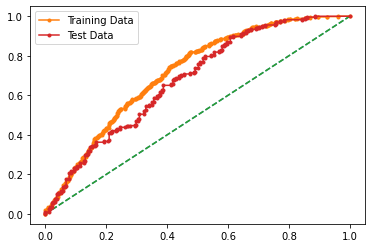

In [466]:
# AUC and ROC for the training data

# calculate AUC
auc = metrics.roc_auc_score(Y_train,pred_prob_train[:,1])
print('AUC for the Training Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(Y_train,pred_prob_train[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label = 'Training Data')


# AUC and ROC for the test data

# calculate AUC
auc = metrics.roc_auc_score(Y_test,pred_prob_test[:,1])
print('AUC for the Test Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(Y_test,pred_prob_test[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label='Test Data')
# show the plot
plt.legend(loc='best')
plt.show()

### LDA

In [470]:
#Build LDA Model
clf = LinearDiscriminantAnalysis()
model=clf.fit(X_train,y_train)

C:\Users\Saravanakumar\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [471]:
#intercept value
clf.intercept_ 

array([1.41796778])

In [472]:
#coefficients for the Linear Discriminant Function
clf.coef_

array([[-0.08152835,  0.3444983 ,  0.13266432,  0.42466978,  1.00368375,
        -0.2407898 ,  0.26215018,  0.13386985, -0.15323066, -0.48830147,
        -0.13303942, -0.26674353,  0.26323157, -0.84836311, -0.31047556]])

In [473]:
X_train.columns

Index(['Wife_age', 'No_of_children_born', 'Husband_Occupation',
       'Wife_education_Secondary', 'Wife_education_Tertiary',
       'Wife_education_Uneducated', 'Husband_education_Secondary',
       'Husband_education_Tertiary', 'Husband_education_Uneducated',
       'Wife_religion_Scientology', 'Wife_Working_Yes',
       'Standard_of_living_index_Low', 'Standard_of_living_index_Very High',
       'Standard_of_living_index_Very Low', 'Media_exposure_Not-Exposed'],
      dtype='object')

In [474]:
a=clf.coef_
np.round(a,2) # rounded up coefficients 

array([[-0.08,  0.34,  0.13,  0.42,  1.  , -0.24,  0.26,  0.13, -0.15,
        -0.49, -0.13, -0.27,  0.26, -0.85, -0.31]])

In [475]:
# Training Data Class Prediction with a cut-off value of 0.5
pred_class_train = model.predict(X_train)

# Test Data Class Prediction with a cut-off value of 0.5
pred_class_test = model.predict(X_test)

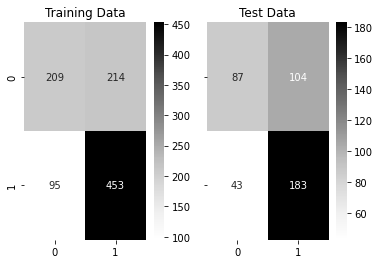

In [476]:
f,a =  plt.subplots(1,2,sharex=True,sharey=True,squeeze=False)

#Plotting confusion matrix for the different models for the Training Data

plot_0 = sns.heatmap((metrics.confusion_matrix(Y_train,pred_class_train)),annot=True,fmt='.5g',cmap='Greys',ax=a[0][0]);
a[0][0].set_title('Training Data')

plot_1 = sns.heatmap((metrics.confusion_matrix(Y_test,pred_class_test)),annot=True,fmt='.5g',cmap='Greys',ax=a[0][1]);
a[0][1].set_title('Test Data');


In [477]:
print('Classification Report of the training data:\n\n',metrics.classification_report(Y_train,pred_class_train),'\n')
print('Classification Report of the test data:\n\n',metrics.classification_report(Y_test,pred_class_test),'\n')

Classification Report of the training data:

               precision    recall  f1-score   support

           0       0.69      0.49      0.57       423
           1       0.68      0.83      0.75       548

    accuracy                           0.68       971
   macro avg       0.68      0.66      0.66       971
weighted avg       0.68      0.68      0.67       971
 

Classification Report of the test data:

               precision    recall  f1-score   support

           0       0.67      0.46      0.54       191
           1       0.64      0.81      0.71       226

    accuracy                           0.65       417
   macro avg       0.65      0.63      0.63       417
weighted avg       0.65      0.65      0.63       417
 



In [478]:
# Training Data Probability Prediction
pred_prob_train = model.predict_proba(X_train)

# Test Data Probability Prediction
pred_prob_test = model.predict_proba(X_test)

In [479]:
pred_prob_train[:,1]

array([0.76540702, 0.3687515 , 0.63065806, 0.79119025, 0.22518166,
       0.564679  , 0.75626097, 0.70401934, 0.65673863, 0.41768851,
       0.24094933, 0.57228196, 0.82567023, 0.2622956 , 0.81864708,
       0.79232108, 0.69199488, 0.05110369, 0.56960387, 0.78601766,
       0.56472107, 0.41478819, 0.24995294, 0.72411207, 0.79575623,
       0.5925759 , 0.54033035, 0.52785819, 0.23871253, 0.71621526,
       0.90407522, 0.69766267, 0.68339222, 0.74956509, 0.18189276,
       0.60435949, 0.68951643, 0.4527783 , 0.46485782, 0.72666433,
       0.80066825, 0.6899652 , 0.36586562, 0.37139484, 0.54130083,
       0.54150193, 0.66589003, 0.3822749 , 0.49756371, 0.60561475,
       0.79693139, 0.79575623, 0.61635485, 0.24519726, 0.06539094,
       0.29527176, 0.8213013 , 0.75947524, 0.78785658, 0.77973279,
       0.4838569 , 0.56845815, 0.71868956, 0.79589469, 0.54944912,
       0.71749847, 0.66130539, 0.73998157, 0.58196279, 0.40412757,
       0.68339222, 0.68788252, 0.33999005, 0.74298165, 0.32626

AUC for the Training Data: 0.714
AUC for the Test Data: 0.680


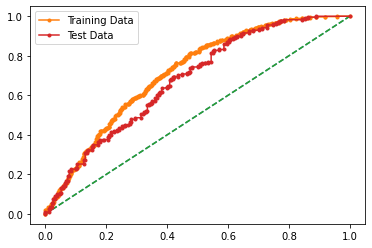

In [480]:
# AUC and ROC for the training data

# calculate AUC
auc = metrics.roc_auc_score(Y_train,pred_prob_train[:,1])
print('AUC for the Training Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(Y_train,pred_prob_train[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label = 'Training Data')


# AUC and ROC for the test data

# calculate AUC
auc = metrics.roc_auc_score(Y_test,pred_prob_test[:,1])
print('AUC for the Test Data: %.3f' % auc)

#  calculate roc curve
fpr, tpr, thresholds = metrics.roc_curve(Y_test,pred_prob_test[:,1])
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.',label='Test Data')
# show the plot
plt.legend(loc='best')
plt.show()

### CART

In [483]:
from sklearn.tree import DecisionTreeClassifier
# splitting data into training and test set for independent attributes
from sklearn.model_selection import train_test_split

X_train, X_test, train_labels, test_labels = train_test_split(X, y, test_size=.30, random_state=1)


In [484]:

reg_dt_model = DecisionTreeClassifier(criterion = 'gini', max_depth = 7,min_samples_leaf=10,min_samples_split=30)
reg_dt_model.fit(X_train, train_labels)

DecisionTreeClassifier(max_depth=7, min_samples_leaf=10, min_samples_split=30)

In [485]:
ytrain_predict = reg_dt_model.predict(X_train)
ytest_predict = reg_dt_model.predict(X_test)

In [486]:
import matplotlib.pyplot as plt

AUC: 0.829


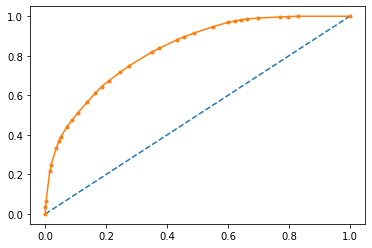

In [487]:
# AUC and ROC for the training data

# predict probabilities
probs = reg_dt_model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(train_labels, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(train_labels, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

AUC: 0.726


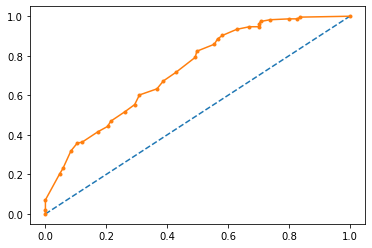

In [488]:
# AUC and ROC for the test data


# predict probabilities
probs = reg_dt_model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(test_labels, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(test_labels, probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [489]:
from sklearn.metrics import classification_report,confusion_matrix

In [490]:
print(classification_report(train_labels, ytrain_predict))

              precision    recall  f1-score   support

           0       0.74      0.65      0.69       423
           1       0.75      0.82      0.78       548

    accuracy                           0.75       971
   macro avg       0.74      0.73      0.74       971
weighted avg       0.74      0.75      0.74       971



In [491]:
print(classification_report(test_labels, ytest_predict))

              precision    recall  f1-score   support

           0       0.67      0.51      0.58       191
           1       0.66      0.79      0.72       226

    accuracy                           0.66       417
   macro avg       0.66      0.65      0.65       417
weighted avg       0.66      0.66      0.65       417



In [492]:
confusion_matrix(train_labels, ytrain_predict)

array([[275, 148],
       [ 99, 449]], dtype=int64)

In [493]:
confusion_matrix(test_labels, ytest_predict)

array([[ 97,  94],
       [ 47, 179]], dtype=int64)

In [494]:
reg_dt_model.score(X_train,train_labels)

0.7456230690010298

In [495]:
reg_dt_model.score(X_test,test_labels)

0.6618705035971223